In [1]:
import os
import json

import numpy as np
from pathlib import Path

# Specify the folder containing JSON files
folder_path = './arkitscenes_pairs/Test'

In [2]:
file_name = folder_path + "/scene_list.json"
print(file_name)

with open(file_name, 'r') as file:
    scene_list = json.load(file)

    print(scene_list)

./arkitscenes_pairs/Test/scene_list.json
['45663206', '41126514', '45261728', '41126453', '45261201', '45261164', '41126467', '47204861', '41249059', '41126383', '41126554', '41126500', '47204856', '47204325', '41126619', '45261228', '45261203', '41249065', '41126534', '41126307', '47204842', '45261230', '41126598', '41159368', '41126439', '41126541', '41126567', '41126516', '45663205', '41126597', '41126367', '45261246', '41126305', '45261248', '47204319', '45261277', '41126417', '41126446', '45261713', '41126589', '41126401', '41159375', '45261167', '41125976', '41126526', '41125937', '41159369', '45261689', '45261251', '45261681', '47204330', '41126518', '41249056', '41126550', '45261265', '41126543', '41126580', '45261172', '47204341', '41392191', '41126297', '41126498', '41159381', '41126466', '45261158', '45261709', '47204322', '47204836', '41126592', '45261269', '41125972', '41126494', '41126533', '45261169', '45261206', '45261686', '45261662', '41249063', '47204350', '41126603'

In [3]:
missing = False
for scene in scene_list:
    scene_path = Path(folder_path) / scene
    missing = missing and not os.path.isdir(scene_path)

print("Some folder is missing?", missing)

Some folder is missing? False


In [4]:
print(len(scene_list))
# maybe we can evaluate the depth maps for 100-1000 pairs for each Test scene ?

print(100*len(scene_list))

154
15400


In [5]:
gt_path = Path('/data3/sebastian.cavada/datasets/arkitscenes_test/Test')

In [6]:
import sys
import imageio.v2 as imageio
import matplotlib.pyplot as plt

from typing import Set
sys.path.append('/home/sebastian.cavada/scsv/thesis/mast3r_mine/dust3r')

from dust3r.utils.geometry import depthmap_to_pts3d, depthmap_to_camera_coordinates, depthmap_to_absolute_camera_coordinates # nofq



arkitscenes_pairs/Test/41126453/selected_pairs.npz
NpzFile 'arkitscenes_pairs/Test/41126453/selected_pairs.npz' with keys: selection, pairs, sky_direction_scene
98
51
51
100
[ 5. 42.]
[[-0.49226679 -0.05884664  0.86845292 -0.39389293]
 [-0.87034379  0.04844338 -0.49005605  0.56289889]
 [-0.01323264 -0.99709092 -0.07506387  0.89142121]
 [ 0.          0.          0.          1.        ]]
/data3/sebastian.cavada/datasets/arkitscenes_test/Test/41126453/vga_wide/41126453_4653.488.jpg
/data3/sebastian.cavada/datasets/arkitscenes_test/Test/41126453/vga_wide/41126453_4652.088.jpg


/home/sebastian.cavada/micromamba/envs/mast3r/lib/python3.11/site-packages/imageio/plugins/pillow.py:320: UserWarning: Loading 16-bit (uint16) PNG as int32 due to limitations in pillow's PNG decoder. This will be fixed in a future version of pillow which will make this warning dissapear.
  warnings.warn(


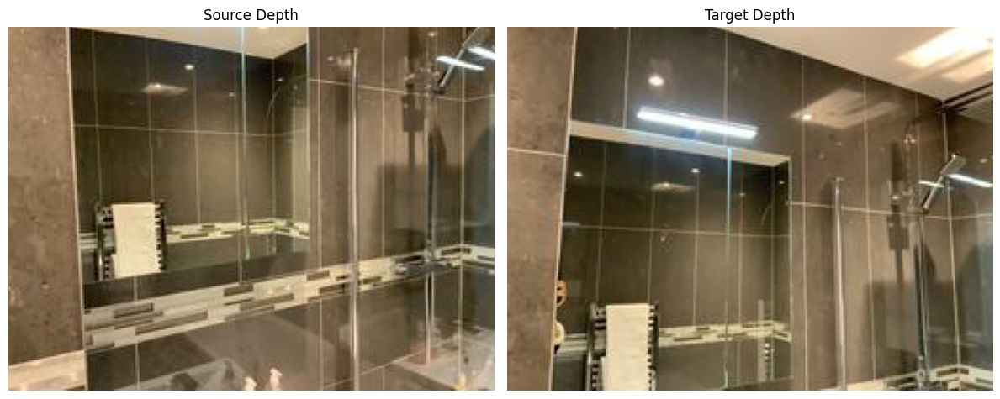

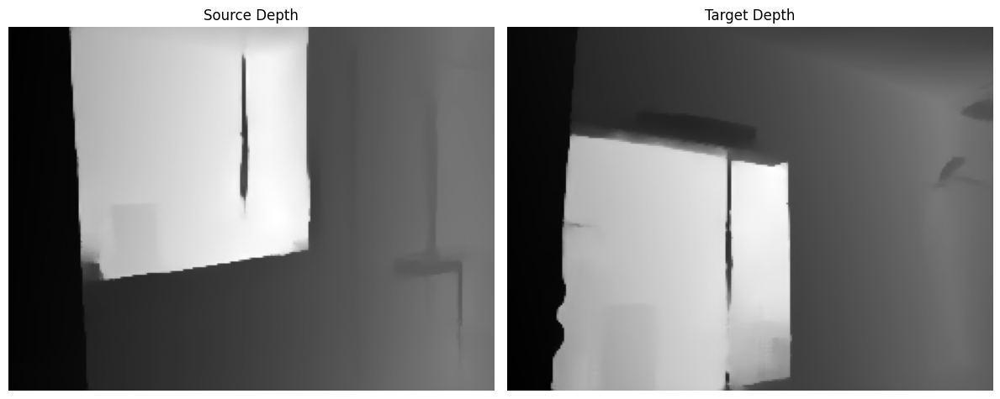

<class 'numpy.ndarray'>
[[256.     192.     211.949  211.949  127.933   95.9333]
 [256.     192.     211.949  211.949  127.933   95.9333]
 [256.     192.     211.949  211.949  127.933   95.9333]
 [256.     192.     211.949  211.949  127.933   95.9333]
 [256.     192.     211.949  211.949  127.933   95.9333]
 [256.     192.     211.949  211.949  127.933   95.9333]
 [256.     192.     211.949  211.949  127.933   95.9333]
 [256.     192.     211.949  211.949  127.933   95.9333]
 [256.     192.     211.949  211.949  127.933   95.9333]
 [256.     192.     211.949  211.949  127.933   95.9333]
 [256.     192.     211.949  211.949  127.933   95.9333]
 [256.     192.     211.949  211.949  127.933   95.9333]
 [256.     192.     211.949  211.949  127.933   95.9333]
 [256.     192.     211.949  211.949  127.933   95.9333]
 [256.     192.     211.949  211.949  127.933   95.9333]
 [256.     192.     211.949  211.949  127.933   95.9333]
 [256.     192.     211.949  211.949  127.933   95.9333]
 [256. 

In [7]:
np.random.seed(42)

for scene in scene_list[3:4]:    
    scene_path = Path(folder_path) / scene / "selected_pairs.npz"
    print(scene_path)
    data = np.load(scene_path, allow_pickle=True)  # allow_pickle=True is optional; depends on the file content.
    print(data)
    print(len(data['selection']))        

    # the common elements are all in the gt_data
    # common_elements = list(set(data['selection']) & set(gt_data['images']))
    # # intersection = [item for item in data['selection'] if item in gt_data['images']]
    # print(len(common_elements))

    gt_file_path = gt_path / scene / "scene_metadata.npz"
    gt_data = np.load(gt_file_path, allow_pickle=True)
    selected_indexes = np.random.randint(0, len(gt_data['pairs']), 100)
    selected_pairs = gt_data['pairs'][selected_indexes]    
    print(len(gt_data['images']))    
    print(len(gt_data['intrinsics']))
    print(len(selected_pairs))

    # okay here then we need to convert depth maps to 3D point cloudsss HOW boh vediamo pomeriggio

    for pair in selected_pairs[:1]:
        print(pair[:2])

        print(gt_data['trajectories'][int(pair[0])] )
        
        src_depth = gt_data['images'][int(pair[0])] 
        target_depth = gt_data['images'][int(pair[1])]

        src_depth_path = gt_path / scene / "lowres_depth" / src_depth
        target_depth_path = gt_path / scene / "lowres_depth" / target_depth

        src_rgb_path = gt_path / scene / "vga_wide" / src_depth.replace('.png', '.jpg')
        target_rgb_path = gt_path / scene / "vga_wide" / target_depth.replace('.png', '.jpg')

        src_depth_image = imageio.imread(src_depth_path)
        target_depth_image = imageio.imread(target_depth_path)    

        src_rgb_image = imageio.imread(src_rgb_path)
        target_rgb_image = imageio.imread(target_rgb_path)

        print(src_rgb_path)
        print(target_rgb_path)

        # Create a figure with two subplots side by side
        fig, axes = plt.subplots(1, 2, figsize=(12, 6))

        # Display the source depth image
        axes[0].imshow(src_rgb_image)  # Use 'gray' colormap for depth maps
        axes[0].set_title('Source Depth')
        axes[0].axis('off')  # Hide axis

        # Display the target depth image
        axes[1].imshow(target_rgb_image)
        axes[1].set_title('Target Depth')
        axes[1].axis('off')

        # Adjust layout and display
        plt.tight_layout()
        plt.show()

                # Create a figure with two subplots side by side
        fig, axes = plt.subplots(1, 2, figsize=(12, 6))

        # Display the source depth image
        axes[0].imshow(src_depth_image, cmap='gray')  # Use 'gray' colormap for depth maps
        axes[0].set_title('Source Depth')
        axes[0].axis('off')  # Hide axis

        # Display the target depth image
        axes[1].imshow(target_depth_image, cmap='gray')
        axes[1].set_title('Target Depth')
        axes[1].axis('off')

        # Adjust layout and display
        plt.tight_layout()
        plt.show()

        print(type(src_depth_image))
        print(gt_data['intrinsics'])

        fx, fy, cx, cy = gt_data['intrinsics'][int(pair[0])][2:]
        camera_intrinsics = np.eye(3)
        camera_intrinsics[0,0] = fx
        camera_intrinsics[1,1] = fy
        camera_intrinsics[0,2] = cx
        camera_intrinsics[1,2] = cy
        print(camera_intrinsics)

        camera_extrinsics_img1 = gt_data['trajectories'][int(pair[0])]
        camera_extrinsics_img2 = gt_data['trajectories'][int(pair[1])] 
        
        pts3d_img1, valid_mask_img1 = depthmap_to_absolute_camera_coordinates(src_depth_image, camera_intrinsics, camera_extrinsics_img1)
        pts3d_img2, valid_mask_img2 = depthmap_to_absolute_camera_coordinates(target_depth_image, camera_intrinsics, camera_extrinsics_img2)

        # X_cam, valid_mask = depthmap_to_camera_coordinates(src_depth_image, camera_intrinsics)
        print(pts3d_img1.shape)
        print(pts3d_img2.shape)

                


In [8]:
type(src_rgb_image)

numpy.ndarray

In [9]:
import plotly.graph_objects as go
import numpy as np

def plot_3d_points_with_color(points, colors=None, valid_mask=None):
    """
    Plots 3D points with RGB colors interactively.
    
    Parameters:
        points (numpy array): 3D points with shape (N, 3).
        colors (numpy array): RGB colors for each point (N, 3) in [0, 255] format.
        valid_mask (numpy array): Optional mask to filter points (shape N, boolean array).
    """
    print(valid_mask.shape)
    print(points.shape)
    print(colors.shape)
    # print(sum(valid_mask))
    if valid_mask is not None:
        points = points[valid_mask]
        if colors is not None:
            colors = colors[valid_mask]

    # Normalize RGB values to [0, 1] for Plotly
    if colors is not None:
        colors = colors / 255.0        
        color_values = ['rgb({:.0f},{:.0f},{:.0f})'.format(c[0] * 255, c[1] * 255, c[2] * 255) for c in colors]
    else:
        color_values = 'blue'  # Default color if no RGB is provided

    # Create the scatter3D plot
    scatter = go.Scatter3d(
        x=points[:, 0],
        y=points[:, 1],
        z=points[:, 2],
        mode='markers',
        marker=dict(
            size=2,
            color=color_values,  # Set marker color
        )
    )

    layout = go.Layout(
        scene=dict(
            xaxis_title='X',
            yaxis_title='Y',
            zaxis_title='Z',
        ),
        title='Interactive 3D Points with RGB Colors',
    )

    fig = go.Figure(data=[scatter], layout=layout)
    fig.show(renderer="notebook")


# Example usage:
# Assuming `pts3d_img2` is your (N, 3) array of points
# Assuming `rgb_colors` is your (N, 3) array of RGB values in [0, 255]
# Assuming `valid_mask_img1` is your boolean mask for valid points
plot_3d_points_with_color(pts3d_img1, colors=src_rgb_image, valid_mask=valid_mask_img1)

(192, 256)
(192, 256, 3)
(192, 256, 3)


In [10]:
plot_3d_points_with_color(pts3d_img2, colors=target_rgb_image, valid_mask=valid_mask_img2)

(192, 256)
(192, 256, 3)
(192, 256, 3)


In [12]:
pts3d_img1.shape

# step 1 map back to camera coordinates


# step 2 map to 2D points given intrinsics

(192, 256, 3)

In [13]:
pts3d_img1, valid_mask_img1 = depthmap_to_camera_coordinates(src_depth_image, camera_intrinsics)

print(pts3d_img1.shape)

(192, 256, 3)


In [14]:
plot_3d_points_with_color(pts3d_img1, colors=target_rgb_image, valid_mask=valid_mask_img1)

(192, 256)
(192, 256, 3)
(192, 256, 3)


In [15]:
target_rgb_image.shape

(192, 256, 3)

In [16]:
import torch


In [17]:
camera_intrinsics

array([[211.949 ,   0.    , 127.933 ],
       [  0.    , 211.949 ,  95.9333],
       [  0.    ,   0.    ,   1.    ]])

In [18]:

X_cam = pts3d_img1[:, :, 0]
Y_cam = pts3d_img1[:, :, 1]
Z_cam = pts3d_img1[:, :, 2]

f_u, f_v, c_u, c_v = gt_data['intrinsics'][int(pair[0])][2:]

print(f_u, f_v, c_u, c_v)

H, W, _ = target_rgb_image.shape
print(H, W)

211.949 211.949 127.933 95.9333
192 256


In [24]:

u = (f_u * X_cam / Z_cam) + c_u
v = (f_v * Y_cam / Z_cam) + c_v

print(u.shape)

# Stack into (N, 2) array
pts_2d = np.stack([u, v], axis=-1)
print(pts_2d.shape)


(192, 256)
(192, 256, 2)


Projected 2D points (pixels):
torch.Size([192, 256, 2])


/tmp/ipykernel_157392/3474112498.py:18: DeprecationWarning:

__array__ implementation doesn't accept a copy keyword, so passing copy=False failed. __array__ must implement 'dtype' and 'copy' keyword arguments. To learn more, see the migration guide https://numpy.org/devdocs/numpy_2_0_migration_guide.html#adapting-to-changes-in-the-copy-keyword



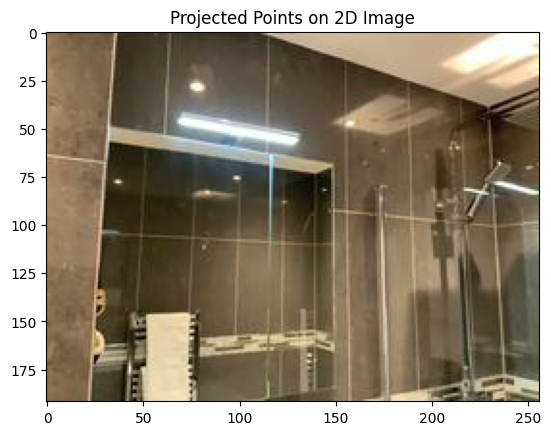

In [36]:
# Display results
print("Projected 2D points (pixels):")
print(pts_2d.shape)

# Simulate an image and plot the projections
image = np.zeros((192, 256, 3), dtype=np.uint8)

# Convert inputs to torch tensors if they aren't already
if not isinstance(pts_2d, torch.Tensor):
    pts_2d = torch.from_numpy(pts_2d)
if not isinstance(target_rgb_image, torch.Tensor):
    target_rgb_image = torch.from_numpy(target_rgb_image)
    
pts_2d_int = pts_2d.round().long()

for x in range(pts_2d.shape[0]):
    for j in range(pts_2d.shape[1]):
        image[int(pts_2d_int[x, j, 1]), int(pts_2d_int[x, j, 0])] = target_rgb_image[x, j]
        # print(pts_2d[x, j])
   
# Show the image with projections
plt.imshow(image)
plt.title("Projected Points on 2D Image")
plt.show()

In [28]:
pts_2d[0].shape

(256, 2)

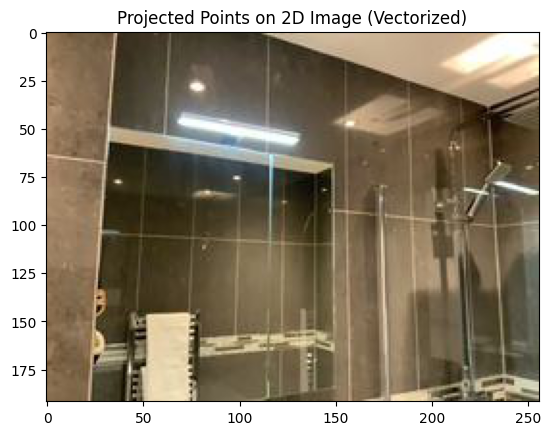

In [37]:
def project_points_torch(pts_2d, target_rgb_image, image_height=192, image_width=256):
    """
    Vectorized point projection using PyTorch
    
    Args:
        pts_2d: Tensor of shape (N, M, 2) containing 2D coordinates
        target_rgb_image: Tensor of shape (N, M, 3) containing RGB values
        image_height: Height of the output image
        image_width: Width of the output image
    
    Returns:
        Projected image as a tensor
    """
    # Convert inputs to torch tensors if they aren't already
    if not isinstance(pts_2d, torch.Tensor):
        pts_2d = torch.from_numpy(pts_2d)
    if not isinstance(target_rgb_image, torch.Tensor):
        target_rgb_image = torch.from_numpy(target_rgb_image)
    
    # Create empty image tensor
    image = torch.zeros(image_height, image_width, 3, dtype=torch.uint8)
    
    # Round coordinates to integers
    pts_2d_int = pts_2d.round().long()
    
    # Clip coordinates to image boundaries
    pts_2d_int[..., 0] = torch.clamp(pts_2d_int[..., 0], 0, image_width - 1)
    pts_2d_int[..., 1] = torch.clamp(pts_2d_int[..., 1], 0, image_height - 1)
    
    # Flatten the point coordinates and RGB values
    flat_coords = pts_2d_int.reshape(-1, 2)
    flat_colors = target_rgb_image.reshape(-1, 3)
    
    # Use scatter_ to place RGB values at corresponding coordinates
    image[flat_coords[:, 1], flat_coords[:, 0]] = flat_colors
    
    return image

# Create the projected image
image = project_points_torch(pts_2d, target_rgb_image)

# Display the result
plt.imshow(image.numpy())
plt.title("Projected Points on 2D Image (Vectorized)")
plt.show()


In [ ]:
import torch
import torch.nn.functional as F

def project_points_differentiable(pts_2d, target_rgb_image, image_height=192, image_width=256):
    """
    Differentiable point projection using grid_sample for bilinear interpolation
    
    Args:
        pts_2d: Tensor of shape (N, M, 2) containing 2D coordinates
        target_rgb_image: Tensor of shape (N, M, 3) containing RGB values
        image_height: Height of the output image
        image_width: Width of the output image
    
    Returns:
        Projected image as a tensor with gradients
    """
    # Ensure inputs are float tensors
    if not isinstance(pts_2d, torch.Tensor):
        pts_2d = torch.from_numpy(pts_2d).float()
    if not isinstance(target_rgb_image, torch.Tensor):
        target_rgb_image = torch.from_numpy(target_rgb_image).float()
    
    # Normalize coordinates to [-1, 1] range as required by grid_sample
    pts_2d_normalized = torch.stack([
        2 * pts_2d[..., 0] / (image_width - 1) - 1,
        2 * pts_2d[..., 1] / (image_height - 1) - 1
    ], dim=-1)
    
    # Reshape points for grid_sample (B, H, W, 2)
    grid = pts_2d_normalized.unsqueeze(0)
    
    # Reshape colors for grid_sample (B, C, H, W)
    colors = target_rgb_image.permute(2, 0, 1).unsqueeze(0)
    
    # Apply bilinear sampling
    sampled = F.grid_sample(
        colors, 
        grid,
        mode='bilinear',
        align_corners=True,
        padding_mode='zeros'
    )
    
    # Reshape to image format (H, W, C)
    image = sampled[0].permute(1, 2, 0)
    
    return image

# Example usage with gradient computation:
"""
# Make inputs require gradients
pts_2d = torch.tensor(pts_2d, requires_grad=True)
target_rgb_image = torch.tensor(target_rgb_image, requires_grad=True)

# Project points
image = project_points_differentiable(pts_2d, target_rgb_image)

# Compute some loss
loss = image.mean()
loss.backward()

# Now pts_2d.grad and target_rgb_image.grad contain gradients
"""

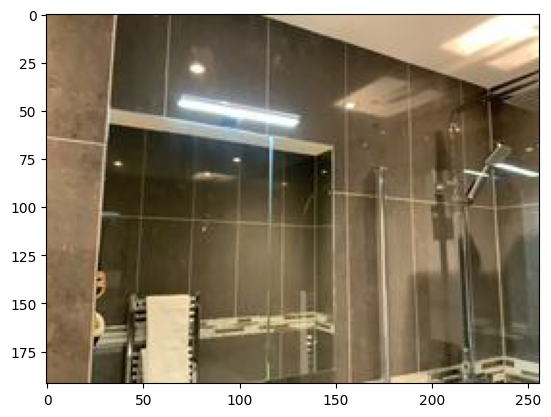

In [43]:
import torch
import torch.nn.functional as F

def project_points_differentiable(pts_2d, target_rgb_image, image_height=192, image_width=256):
    """
    Differentiable point projection using grid_sample for bilinear interpolation
    
    Args:
        pts_2d: Tensor of shape (N, M, 2) containing 2D coordinates
        target_rgb_image: Tensor of shape (N, M, 3) containing RGB values
        image_height: Height of the output image
        image_width: Width of the output image
    
    Returns:
        Projected image as a tensor with gradients
    """
    # Convert to float32 tensors
    if not isinstance(pts_2d, torch.Tensor):
        pts_2d = torch.from_numpy(pts_2d).float()
    else:
        pts_2d = pts_2d.float()
        
    if not isinstance(target_rgb_image, torch.Tensor):
        target_rgb_image = torch.from_numpy(target_rgb_image).float()
    else:
        target_rgb_image = target_rgb_image.float()
    
    # Normalize coordinates to [-1, 1] range
    pts_2d_normalized = torch.stack([
        2 * pts_2d[..., 0] / (image_width - 1) - 1,
        2 * pts_2d[..., 1] / (image_height - 1) - 1
    ], dim=-1)
    
    # Reshape points for grid_sample (B, H, W, 2)
    grid = pts_2d_normalized.unsqueeze(0)
    
    # Reshape colors and convert to float [0,1] range if needed
    if target_rgb_image.max() > 1.0:
        target_rgb_image = target_rgb_image / 255.0
    colors = target_rgb_image.permute(2, 0, 1).unsqueeze(0)
    
    # Apply bilinear sampling
    sampled = F.grid_sample(
        colors, 
        grid,
        mode='bilinear',
        align_corners=True,
        padding_mode='zeros'
    )
    
    # Reshape to image format (H, W, C) and rescale to [0,255]
    image = sampled[0].permute(1, 2, 0) * 255.0
    
    return image

# Example usage:

image = project_points_differentiable(pts_2d, target_rgb_image)

# If you need uint8 for display:
image_uint8 = image.round().byte()
plt.imshow(image_uint8.detach().numpy())
plt.show()
